In [2]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt

from glob import glob

import librosa
import librosa.display
import IPython.display as ipd

In [3]:
audio_files = glob('./music_data/*.wav')
audio_files

['./music_data\\Axollo-Burn_It.wav',
 './music_data\\Curbi-What_You_Like.wav',
 './music_data\\Robin_Hustin_Jessica_Chertock-Burn_it_Down.wav',
 './music_data\\Slow-ambient-new-age-song.wav']

In [4]:
ipd.Audio(audio_files[0])
# this only read, if you want to use manipulate us librosa

In [12]:
y , sr = librosa.load(audio_files[1]) # y is raw data + sr is sample rate of music

In [18]:
print('y : {}'.format(y[:10]))
print('shape y : {}'.format(y.shape))
print('sample rate : {}'.format(sr)) # 1s = 22050

y : [ 7.2294042e-06  2.4719438e-06  1.1922950e-06  1.4705320e-06
 -8.2757315e-06  1.1226743e-06  3.8208173e-06 -1.0582276e-06
  4.8723573e-06 -1.6378606e-06]
shape y : (3500115,)
sample rate : 22050


### 테마노트는 
#### https://teddylee777.github.io/visualization/matplotlib-colorcode 에서

<AxesSubplot:title={'center':'Audio example'}>

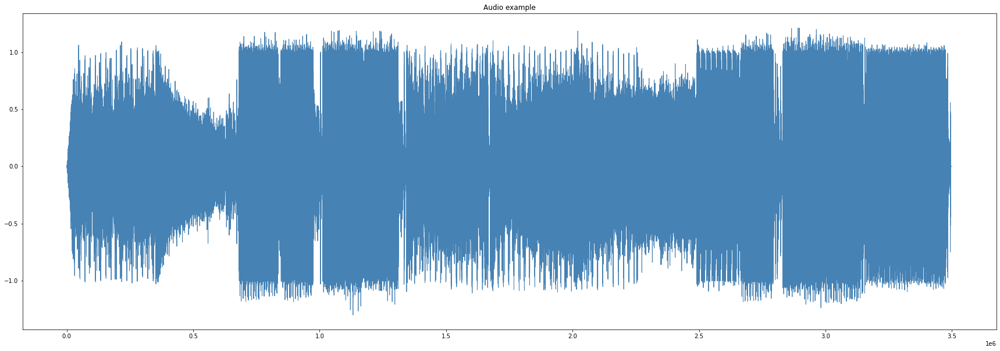

In [34]:
Ser = pd.Series(y) # array를 1열로 정렬
#pd. dataframe #data array를 각각의 열로 정렬 
Ser.plot(figsize =(30, 10), 
         lw = 1, 
         title = 'Audio example',
         color = 'steelblue')

#### trimm 시키는 방법, (조용한 부분 제거)

<AxesSubplot:title={'center':'Audio trimmed example'}>

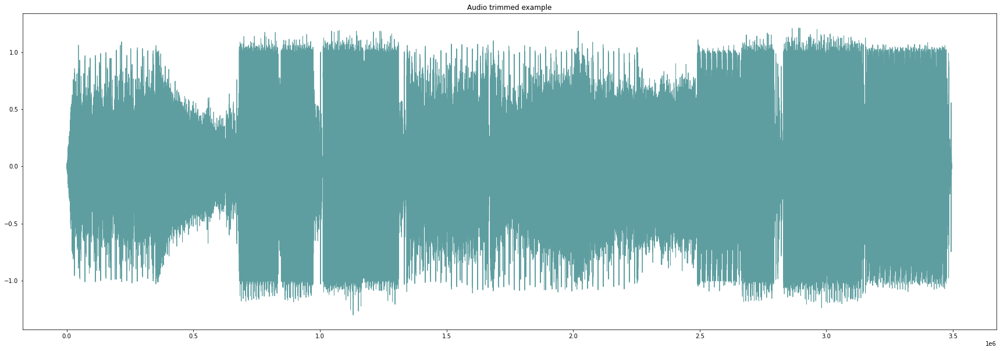

In [39]:
y_trimmed, _ = librosa.effects.trim(y) # _ 는 idx of value 부분이라 필요가 없음
pd.Series(y_trimmed).plot(figsize =(30, 10), 
                          lw = 1,
                          title = 'Audio trimmed example',
                          color = 'cadetblue')

#### zoom in

<AxesSubplot:title={'center':'Audio trimmed example'}>

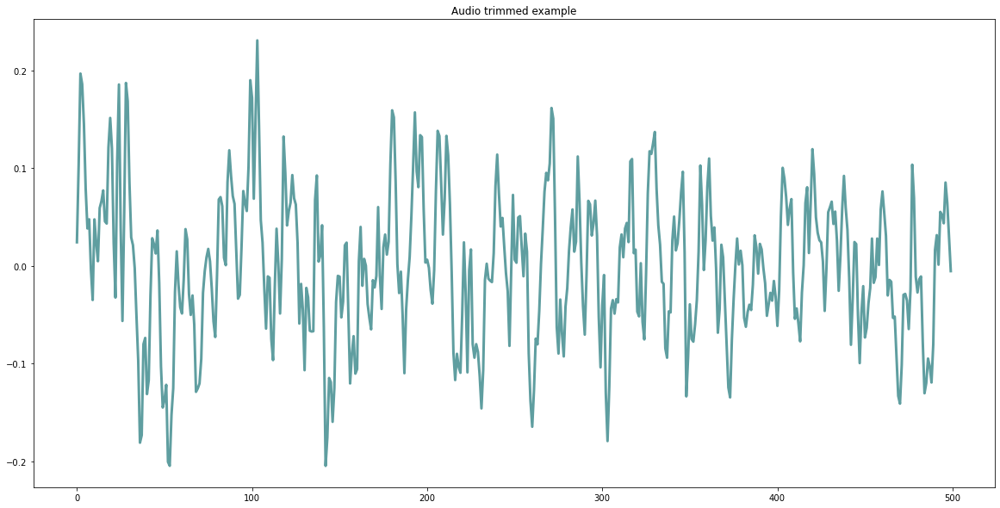

In [47]:
pd.Series(y[50000:50500]).plot(figsize =(20, 10), 
                          lw = 3,
                          title = 'Audio trimmed example',
                          color = 'cadetblue')

### 시간에 따른 주파수 확인하는 법 STFT

In [75]:
y_stft = librosa.stft(y)

s_db = librosa.amplitude_to_db(np.abs(y_stft), ref=np.max)
print(y.shape,"\n",y_stft.shape)
# 무슨 기준인지는 모르겠지만, shape의 [1] 이 time과 관련이 있음, 비율은 43.3~43.4 의 비율

(3500115,) 
 (1025, 6837)


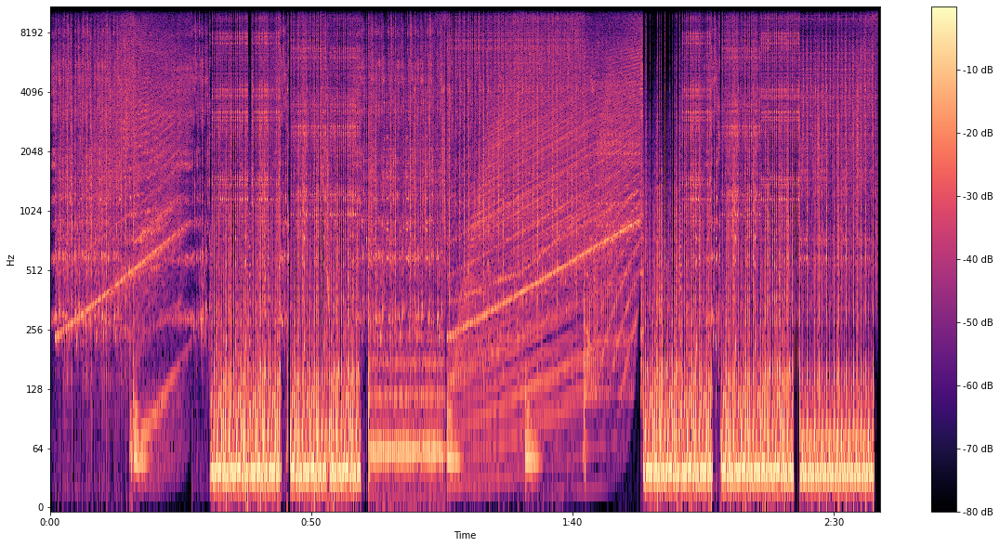

In [74]:
fig, ax = plt.subplots(figsize = (20,10))
img = librosa.display.specshow(s_db, x_axis = 'time', y_axis='log', ax = ax)
fig.colorbar(img, ax=ax, format="%+2.0f dB")
plt.show()

#### Mel Spectogram -> 쉬벌 이게뭐냐
##### https://xangmin.tistory.com/61#:~:text=%EC%A3%BC%ED%8C%8C%EC%88%98%EC%9D%98%20%EB%8B%A8%EC%9C%84%EB%A5%BC%20%EB%8B%A4%EC%9D%8C,%EB%A1%9C%20%EB%B0%94%EA%BE%BC%20%EC%8A%A4%ED%8E%99%ED%8A%B8%EB%9F%BC%EC%9D%84%20%EB%A7%90%ED%95%9C%EB%8B%A4.&text=Mel%2Dscale%EC%9D%80%20%EC%9D%B4%EB%9F%AC%ED%95%9C%20pitch,%EB%B0%98%EC%98%81%ED%95%9C%20scale%20%EB%B3%80%ED%99%98%20%ED%95%A8%EC%88%98%EC%9D%B4%EB%8B%A4.
##### https://sswwd.tistory.com/4

### pitch에서 발견한 사람의 음을 인지하는 기준을 반영한 scale 변환 함수

In [85]:
S = librosa.feature.melspectrogram(y= y, sr = sr, n_mels = 128 * 4) # number of melodyes

s_db_mel = librosa.amplitude_to_db(np.abs(S), ref=np.max)
print(y.shape,"\n",y_stft.shape)

(3500115,) 
 (1025, 6837)


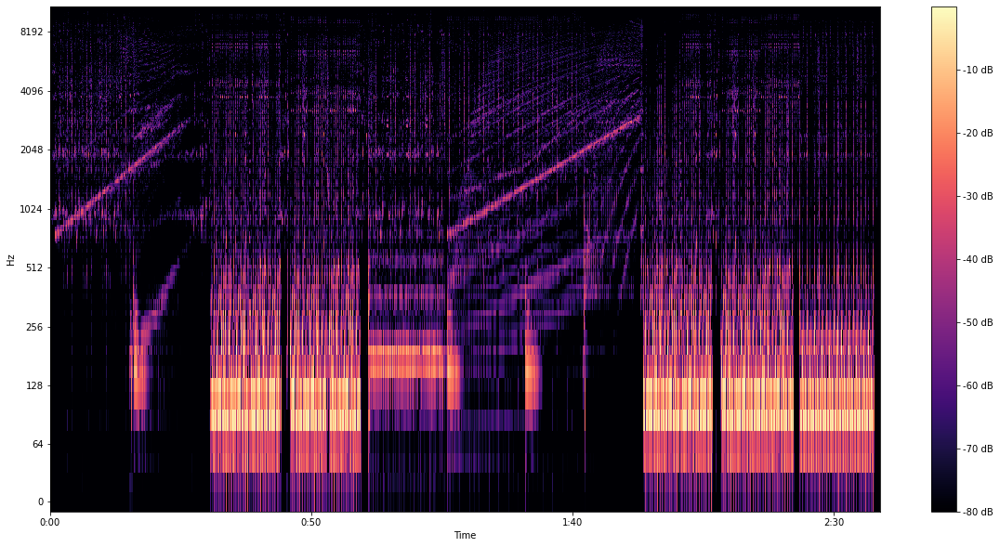

In [86]:
fig, ax = plt.subplots(figsize = (20,10))

img = librosa.display.specshow(s_db_mel, x_axis = 'time', y_axis='log', ax = ax)
fig.colorbar(img, ax=ax, format="%+2.0f dB")
plt.show()